In [1]:
import numpy as np 
import pandas as pd
import math
from scipy import stats
from plotly import tools
import plotly.plotly as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

import seaborn as sns
import matplotlib.pyplot as plt


In [2]:
df=pd.read_csv('hmda_lar.csv',low_memory=False)# load the dataset

In [ ]:
df.head()

In [3]:
df=df[df['action_taken_name']!="Application withdrawn by applicant"]
df=df[df['action_taken_name']!='Loan purchased by the institution']

In [4]:
fips=pd.read_excel("all-geocodes-v2016.xlsx",converters={'County Code (FIPS)': lambda x: str(x)})
fips=fips[fips["State Code (FIPS)"]==17]# state code for illinois
fips['county_code']=fips['State Code (FIPS)'].astype(str).str.cat(fips['County Code (FIPS)'].astype(str))
fips=fips.drop(labels=['Summary Level','State Code (FIPS)','County Code (FIPS)','County Subdivision Code (FIPS)','Place Code (FIPS)','Consolidtated City Code (FIPS)'],axis=1)
fips.columns=['county_name','county_code']

In [5]:
df=pd.merge(df,fips,how="left",on="county_name",sort=False)#merging it into original dataset

In [6]:
df.rename(columns={'county_code_y': 'county_code'}, inplace=True)

In [7]:
county1=pd.DataFrame(df['county_code'].value_counts())
county1=county1.reset_index()
county1.columns=['county_code','number of loans']

# Which county has the highest number of loan applications?

In [9]:
fips=county1['county_code'].tolist()
values=county1['number of loans'].tolist()
endpts = list(np.mgrid[min(values,default=0):max(values,default=0):13j]).sort()

colorscale = ["#141d43","#15425a","#0a6671","#26897d","#67a989","#acc5a6","#e0e1d2",
              "#f0dbce","#e4ae98","#d47c6f","#bb4f61","#952b5f","#651656","#330d35"] 

fig = ff.create_choropleth(
    fips=fips, values=values, scope=['Illinois'], show_state_data=True,
    colorscale=colorscale, binning_endpoints=endpts, round_legend_values=True,
    plot_bgcolor='rgb(229,229,229)',
    paper_bgcolor='rgb(229,229,229)',
    legend_title='Number of Loans by county',
    county_outline={'color': 'rgb(255,255,255)', 'width': 0.2}, exponent_format=False
)
iplot(fig, filename='loans_illinois')

C:\Users\keert\Anaconda3\lib\site-packages\pandas\core\frame.py:6211: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.




In [10]:
df['loan_status']=["approved" if x=="Loan originated" else "not approved" for x in df['action_taken_name']]

# Which county has the highest approval rate?

In [11]:
df_approved=df[df['loan_status']=='approved']
df_notapproved=df[df['loan_status']=='not approved']

In [12]:
county2=pd.DataFrame(df_approved['county_code'].value_counts())
county2=county2.reset_index()
county2.columns=['county_code','number of loans approved']
county2=pd.merge(county2,county1,how="left",on="county_code",sort=False)
l=[]
for x in range(county2.shape[0]):
    l.append(county2['number of loans approved'][x]/county2['number of loans'][x])
county2['approval rate']=[x*100 for x in l]

In [13]:
fips=county2['county_code'].tolist()
values=county2['approval rate'].tolist()
endpts = list(np.mgrid[min(values,default=0):max(values,default=0):13j]).sort()
colorscale = ["#141d43","#15425a","#0a6671","#26897d","#67a989","#acc5a6","#e0e1d2",
              "#f0dbce","#e4ae98","#d47c6f","#bb4f61","#952b5f","#651656","#330d35"]
fig = ff.create_choropleth(
    fips=fips, values=values, scope=['Illinois'], show_state_data=True,
    colorscale=colorscale, binning_endpoints=endpts, round_legend_values=True,
    plot_bgcolor='rgb(229,229,229)',
    paper_bgcolor='rgb(229,229,229)',
    legend_title='Number of approved Loans by county',
    county_outline={'color': 'rgb(255,255,255)', 'width': 0.2},
    exponent_format=True,
)
iplot(fig, filename='approved_loans_washington')

C:\Users\keert\Anaconda3\lib\site-packages\pandas\core\frame.py:6211: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.




# Does your purpose play a role?

In [14]:
df_purpose=pd.crosstab(df['loan_purpose_name'],df['loan_status'])
df_purpose=df_purpose.reset_index()
df_purpose.columns=['purpose','approved count','not approved count']
l=[]
for x in range(3):
    l.append(df_purpose['approved count'][x]/(df_purpose['approved count'][x]+ df_purpose['not approved count'][x]))
df_purpose['percent approved']=[x*100 for x in np.array(l)]
df_purpose['percent not approved']=[100-x for x in df_purpose['percent approved']]

In [15]:
trace1=go.Bar(
x= df_purpose['purpose'],
y= df_purpose['approved count'],
name='approved',
marker=dict(
    color='#009393'))
trace2=go.Bar(
x= df_purpose['purpose'],
y=df_purpose['not approved count'],
name='not approved',
marker=dict(
        color='#930000'))
trace3=go.Bar(
x=df_purpose['purpose'],
y=df_purpose['percent approved'],
name='percent approved',
marker=dict(
    color='#8eb48b'))
trace4=go.Bar(
x=df_purpose['purpose'],
y=df_purpose['percent not approved'],
name="percent not approved",
marker=dict(
        color='#7fc780'))

fig = tools.make_subplots(rows=1, cols=2,subplot_titles=('Approved loans for different purposes','Percent of loans approved for differnet purposes'))
fig.append_trace(trace1,1,1)
fig.append_trace(trace2,1,1)
fig.append_trace(trace3,1,2)
fig.append_trace(trace4,1,2)

fig['layout'].update(height=600, width=900,barmode='stack')
iplot(fig)

This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]



# Which type of loans have a better chance of being approved?

In [16]:
df_type=pd.crosstab(df['loan_type_name'],df['loan_status'])
df_type=df_type.reset_index()
df_type.columns=['type','approved count','not approved count']
l=[]
for x in range(4):
    l.append(df_type['approved count'][x]/(df_type['approved count'][x]+ df_type['not approved count'][x]))
df_type['percent approved']=[x*100 for x in l]
df_type['percent not approved']=[100-x for x in df_type['percent approved']]

In [17]:
trace1 = {"x":df_type['percent approved'] ,
          "y": df_type['type'] ,
          "marker": {"color": "rgba(255, 182, 193, .9)", "size": 20},
          "mode": "markers",
          "name": "percent approved",
          "type": "scatter"
}

trace2 = {"x": df_type['percent not approved'],
          "y": df_type['type'],
          "marker": {"color": "rgba(152, 0, 0, .8)", "size": 20},
          "mode": "markers",
          "name": "percent not approved",
          "type": "scatter",
}
data = [trace1, trace2]
layout = go.Layout(title="Loan Status for different type of loans",
                  height=500,
                  width=700,
                  autosize=False,
                  margin=go.layout.Margin(
        l=150,
        r=50,
        b=100,
        t=100,
        pad=4
    ))

fig = go.Figure(data=data, layout=layout)
iplot(fig)#let's plot

I use percentage as a measure to avoid any scaling issues. FSA/RHS loans have a good record of getting approved. And even Conventional Loans not issued by government programmes have good chances.

Let's have a look at the distribution of applicant's income and loan amount.

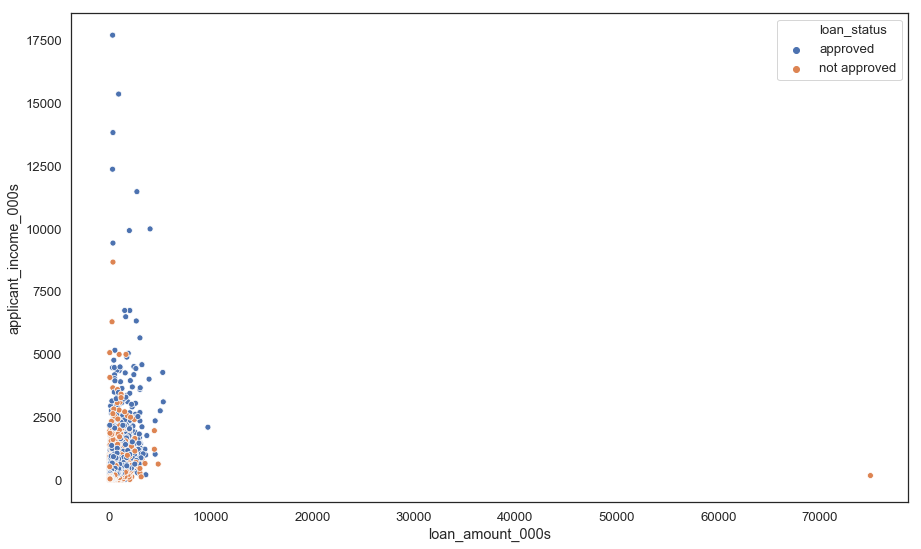

In [18]:
sns.set(style="white", palette="deep", font_scale=1.2, 
        rc={"figure.figsize":(15,9)})
ax = sns.scatterplot(x="loan_amount_000s", y="applicant_income_000s", hue="loan_status",data=df)

A person with a low income gets a loan for a not so large amount around 10000(right outlier blue dot). However the orange dots in the top-left corner can be justified as applications get rejected for lack of documents or unverifiable credentials.

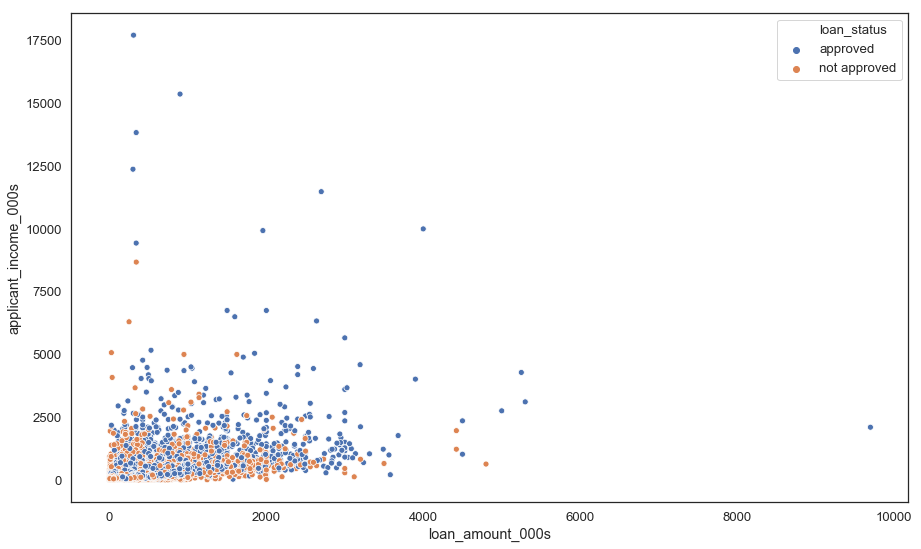

In [19]:
df_temp=df[df['loan_amount_000s']<15000]
ax = sns.scatterplot(x="loan_amount_000s", y="applicant_income_000s", hue="loan_status",data=df_temp)

# Do homes occupied by owners have a higher chance at getting loans?

In [20]:
df_owner=pd.crosstab(df['owner_occupancy_name'],df['loan_status'])
df_owner=df_owner.reset_index()
df_owner.columns=['owner_occupancy','approved','not approved']
l=[]
for x in range(3):
    l.append(df_owner['approved'][x]/(df_owner['approved'][x]+ df_owner['not approved'][x]))
df_owner['percent approved']=[x*100 for x in l]
df_owner['percent not approved']=[100-x for x in df_owner['percent approved']]

In [21]:
df_hoepa=pd.crosstab(df['hoepa_status_name'],df['loan_status'])
df_hoepa=df_hoepa.reset_index()
df_hoepa.columns=['hoepa_status','approved','not approved']
l=[]
for x in range(2):
    l.append(df_hoepa['approved'][x]/(df_hoepa['approved'][x]+ df_hoepa['not approved'][x]))
df_hoepa['percent approved']=[x*100 for x in l]
df_hoepa['percent not approved']=[100-x for x in df_hoepa['percent approved']]

In [22]:
trace1=go.Bar(
x= df_owner['owner_occupancy'],
y= df_owner['percent approved'],
name='percent approved',
marker=dict(
    color='rgb(158,202,225)'))
trace2=go.Bar(
x= df_owner['owner_occupancy'],
y=df_owner['percent not approved'],
name='percent not approved',
marker=dict(
        color='rgba(219, 64, 82, 0.7)'))
trace3=go.Bar(
x=df_hoepa['hoepa_status'],
y=df_hoepa['percent approved'],
name='percent approved',
marker=dict(
    color='rgba(204,204,204,1)'))
trace4=go.Bar(
x=df_hoepa['hoepa_status'],
y=df_hoepa['percent not approved'],
name="percent not approved",
marker=dict(
        color='rgba(222,45,38,0.8)'))

fig = tools.make_subplots(rows=1, cols=2,subplot_titles=('Approval % for owner occupancy','Approval % for HOEPA Status'))
fig.append_trace(trace1,1,1)
fig.append_trace(trace2,1,1)
fig.append_trace(trace3,1,2)
fig.append_trace(trace4,1,2)

fig['layout'].update(height=600, width=900,barmode='group')
iplot(fig)

This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]



The HOEPA status tells us whether a loan is subject to the Home Ownership and Equity Protection Act or not. From the above chart it seems like 100% of the HOEPA loans got approved.

Homes occupied by owners as principle dwellings have a slightly better chance of getting aprroved when compared to non -owner occupied homes. But the diffference is very less, we can't make a statement with much confidence.

# Does the neighbourhood family income affect your chances of getting a loan?

Instead of disclosing the address, lenders disclose the census tract , which is part of the community where the property is located.Each census tract is located in a Metropolitian Statistical Area/Metropolitian Division (MSA/MD). The hud_median_family_income is the median family income in dollars for the MSA/MD in which the tract is located.

Now , you must be expecting that for a loan to be approved the applicant's income must be quite similar or above the neighbourhood median family income . Right?

Well that turns out to be true!

In [23]:
df['hud_median_family_income_000s']=[x/1000 for x in df['hud_median_family_income']]
df_approved['hud_median_family_income_000s']=[x/1000 for x in df_approved['hud_median_family_income']]
df_notapproved['hud_median_family_income_000s']=[x/1000 for x in df_notapproved['hud_median_family_income']]

In [24]:
approved_msamd_diff=df_approved.groupby('msamd_name').mean()
not_approved_msamd_diff=df_notapproved.groupby('msamd_name').mean()

In [25]:
trace0 = go.Scatter(
    x = approved_msamd_diff.index,
    y = approved_msamd_diff['hud_median_family_income_000s'],
    mode = 'lines+markers',
    name = 'Neighbourhood median family income',
    line = dict(
        color = "#009393")
)
trace1 = go.Scatter(
    x = approved_msamd_diff.index,
    y = approved_msamd_diff['applicant_income_000s'],
    mode = 'lines+markers',
    name = 'Applicant income',
    line= dict( color= "#230405")
)
data=[trace0,trace1]
layout = dict(title = 'Difference in neighborhood median family income and applicant income for approved loans  ',
              xaxis = dict(title = 'MSA/MD'),
              yaxis = dict(title = 'Income'),
              margin=go.layout.Margin(
        l=50,
        r=50,
        b=200,
        t=100,
        pad=4
    )
              )

fig = dict(data=data, layout=layout)

iplot(fig)

# Which property type should you apply for?

There are basically 3 property types, 1-4 family dwelling, multifamily dwelling and manufactured housing.Manufactured homes are housing that is esentially ready for occupancy upon leaving the factory and being transported to a building site.

In [26]:
df_property=pd.crosstab(df['property_type_name'],df['loan_status'])
df_property=df_property.reset_index()

l=[]
for x in range(df_property.shape[0]):
    l.append(df_property['approved'][x]/(df_property['approved'][x]+ df_property['not approved'][x]))
df_property['percent approved']=[x*100 for x in l]
df_property['percent not approved']=[100-x for x in df_property['percent approved']]
df_property['property_type_name']=df_property['property_type_name'].replace("One-to-four family dwelling (other than manufactured housing)",'1-4 Family dwelling')

In [27]:
trace1 = go.Bar(
    y=df_property['property_type_name'],
    x=df_property['percent approved'],
    name='percent approved',
    orientation = 'h',
    marker = dict(
        color = '#7bc043 '
        
    )
)
trace2 = go.Bar(
    y=df_property['property_type_name'],
    x=df_property['percent not approved'],
    name='percent not approved',
    orientation = 'h',
    marker = dict(
        color = '#fdf498 '
       
    )
)

data = [trace1, trace2]
layout = go.Layout(
    barmode='stack',
    title="Effect of Property Type",
    
    margin=go.layout.Margin(
        l=200,
        r=50,
        b=100,
        t=100,
        pad=4
    )
)

fig = go.Figure(data=data, layout=layout)
iplot(fig)

Multifamily-dwelling is a safe choice when going for house loans.

Getting a higher residential mortgage on a multifamily dwelling is easier based on the rental income generated, which can cover or reduce the mortgage.

It's tougher to get a loan for manufactured housing.

Many manufactured home loan programs have strict guidelines about the property condition and age. That’s because manufactured housing tends to depreciate, while traditional home values tend to increase over time.

# What is the effect of tract_to_msamd_income?

tract_to_msamd_income is the percentage of the median family income for the census tract for which the applicant has applied compared to the median family income for the MSA/MD, rounded to two decimal places.

In [28]:
trace0 = go.Scatter(
    x = approved_msamd_diff.index,
    y = approved_msamd_diff['tract_to_msamd_income'],
    mode = 'lines+markers',
    name = 'approved',
    line = dict(
        color = "#a77d5f")
)
trace1 = go.Scatter(
    x = not_approved_msamd_diff.index,
    y = not_approved_msamd_diff['tract_to_msamd_income'],
    mode = 'lines+markers',
    name = 'not approved',
    line= dict( color= "#930000")
)
data=[trace0,trace1]
layout = dict(title = '',
              xaxis = dict(title = 'MSA/MD'),
              yaxis = dict(title = 'tract_to_msamd_income'),
              margin=go.layout.Margin(
        l=50,
        r=50,
        b=200,
        t=100,
        pad=4
    )
              )

fig = dict(data=data, layout=layout)

iplot(fig)

This ratio is greater for approved loans than for non-approved loans for all MSAMD. And this difference matters a lot if you are applying in Kennewick or Yakima.

# How does the lien status affect the loan?

A lien serves to guarantee an underlying obligation of the repayment of a loan. If the underlying obligation is not satisfied, the creditor(lender) may be able to seize the asset that is the subject of the lien.Once executed, a lien becomes the legal right of a creditor to sell the collateral property of a debtor who fails to meet the obligations of a loan or other contract.

Most mortgages are secured by a lien against the property. In the event of a forced liquidation, first lien holders will generally get paid before subordinate lien holders.

In [29]:
df_lien=pd.crosstab(df['lien_status_name'],df['loan_status'])
df_lien=df_lien.reset_index()
df_lien.columns=['lien_status','approved','not approved']
l=[]
for x in range(3):
    l.append(df_lien['approved'][x]/(df_lien['approved'][x]+ df_lien['not approved'][x]))
df_lien['percent approved']=[x*100 for x in l]
df_lien['percent not approved']=[100-x for x in df_lien['percent approved']]

In [30]:
trace1 = go.Bar(
    y=df_lien['lien_status'],
    x=df_lien['percent approved'],
    name='percent approved',
    orientation = 'h',
    marker = dict(
        color = 'rgba(71, 58, 131, 0.8)',
        line = dict(
            color = 'rgba(38, 24, 74, 0.8)',
            width = 3)
    )
)
trace2 = go.Bar(
    y=df_lien['lien_status'],
    x=df_lien['percent not approved'],
    name='percent not approved',
    orientation = 'h',
    marker = dict(
        color = 'rgba(190, 192, 213, 1)',
        line = dict(
            color = 'rgba(164, 163, 204, 0.85)',
            width = 3)
    )
)

data = [trace1, trace2]
layout = go.Layout(
    barmode='group',
    title="Effect of lien status",
    margin=go.layout.Margin(
        l=200,
        r=50,
        b=100,
        t=100,
        pad=4
    )
)

fig = go.Figure(data=data, layout=layout)
iplot(fig)

Loans secured by first lien get approved 70% of the time. Loans not secured by any lien has the highest percentage of not getting approved.

In [31]:
df['applicant_income_range'] = np.nan
l = [df]
for col in l:
    col.loc[col['applicant_income_000s'] <= 100, 'applicant_income_range'] = 'Low'
    col.loc[(col['applicant_income_000s'] > 100) & (col['applicant_income_000s'] <= 200), 'applicant_income_range'] = 'Medium'
    col.loc[col['applicant_income_000s'] > 200, 'applicant_income_range'] = 'High'

In [32]:
df_approved=df[df['loan_status']=='approved']
df_notapproved=df[df['loan_status']=='not approved']

In [33]:
trace0 = go.Box(
    y=df_approved['loan_amount_000s'],
    x=df_approved['applicant_income_range'],
    name='approved',
    marker=dict(
        color='#3D9970'
    )
)
trace1 = go.Box(
    y=df_notapproved['loan_amount_000s'],
    x=df_notapproved['applicant_income_range'],
    name='not approved',
    marker=dict(
        color='#FF4136'
    )
)
data = [trace0, trace1]
layout = go.Layout(
    yaxis=dict(
        title='',
        zeroline=False
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)
iplot(fig)

Okay, this is a very compressed view. Loans with very high loan amount are always rejected for the low and medium salary range applicant. While they may get accepted for applicants falling in the high income range. Let's get a zoomed in view by limiting the loan amount to less than 1500000.

In [34]:
df_approved1=df_approved[df_approved['loan_amount_000s']<10000]
df_notapproved1=df_notapproved[df_notapproved['loan_amount_000s']<10000]

In [35]:
trace0 = go.Box(
    y=df_approved1['loan_amount_000s'],
    x=df_approved1['applicant_income_range'],
    name='approved',
    marker=dict(
        color='#3D9970'
    )
)
trace1 = go.Box(
    y=df_notapproved1['loan_amount_000s'],
    x=df_notapproved1['applicant_income_range'],
    name='not approved',
    marker=dict(
        color='#FF4136'
    )
)
data = [trace0, trace1]
layout = go.Layout(
    yaxis=dict(
        title='',
        zeroline=False
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)
iplot(fig)

In all the income ranges the approved loans have requested for loan amount greater than loans not approved. A usual trend, people generally request for loan amount proportionate to their incomes. In most of the cases , applications where the loan amount far exceeds the applicant's income the loans get rejected.

# Is the lending process discriminatory?

In [36]:
df_sex=pd.crosstab(df['applicant_sex_name'],df['loan_status'])
df_sex=df_sex.reset_index()
df_sex.columns=['sex','approved','not approved']
l=[]
for x in range(df_sex.shape[0]):
    l.append(df_sex['approved'][x]/(df_sex['approved'][x]+ df_sex['not approved'][x]))
df_sex['percent approved']=[x*100 for x in np.array(l)]
df_sex['percent not approved']=[100-x for x in df_sex['percent approved']]
df_sex['sex']=df_sex['sex'].replace('Information not provided by applicant in mail, Internet, or telephone application','Info not provided')

In [37]:
df_ethnicity=pd.crosstab(df['applicant_ethnicity_name'],df['loan_status'])
df_ethnicity=df_ethnicity.reset_index()
df_ethnicity.columns=['ethnicity','approved','not approved']
l=[]
for x in range(df_ethnicity.shape[0]):
    l.append(df_ethnicity['approved'][x]/(df_ethnicity['approved'][x]+ df_ethnicity['not approved'][x]))
df_ethnicity['percent approved']=[x*100 for x in np.array(l)]
df_ethnicity['percent not approved']=[100-x for x in df_ethnicity['percent approved']]
df_ethnicity['ethnicity']=df_ethnicity['ethnicity'].replace('Information not provided by applicant in mail, Internet, or telephone application','Info not provided')

In [38]:
df_race=pd.crosstab(df['applicant_race_name_1'],df['loan_status'])
df_race=df_race.reset_index()
df_race.columns=['race','approved','not approved']
l=[]
for x in range(df_race.shape[0]):
    l.append(df_race['approved'][x]/(df_race['approved'][x]+ df_race['not approved'][x]))
df_race['percent approved']=[x*100 for x in np.array(l)]
df_race['percent not approved']=[100-x for x in df_race['percent approved']]
df_race['race']=df_race['race'].replace('Information not provided by applicant in mail, Internet, or telephone application','Info not provided')

In [39]:
trace0=go.Bar(
x=df_ethnicity['ethnicity'],
y=df_ethnicity['percent approved'],
name='percent approved',
marker=dict(color='#051e3e '))
trace1=go.Bar(x=df_ethnicity['ethnicity'],
              y=df_ethnicity['percent not approved'],
              name='percent not approved',
             marker=dict(
             color='#851e3e '))
trace2=go.Bar(x=df_sex['sex'],
             y=df_sex['percent approved'],
             name='percent approved',
             marker=dict(color='#96ceb4  '))
trace3=go.Bar(x=df_sex['sex'],
             y=df_sex['percent not approved'],
             name='percent not approved',
             marker=dict(color='#ff6f69  '))
trace4=go.Scatter(x=df_race['race'],
                 y=df_race['percent approved'],
                 name='percent approved')
trace5=go.Scatter(x=df_race['race'],
                 y=df_race['percent not approved'],
                 name='percent not approved')
fig = tools.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Applicant Race','Applicant sex', 'Applicant ethnicity'))

fig.append_trace(trace0, 1, 1)
fig.append_trace(trace1, 1, 1)
fig.append_trace(trace2, 1, 2)
fig.append_trace(trace3, 1, 2)
fig.append_trace(trace4, 2, 1)
fig.append_trace(trace5, 2, 1)

fig['layout'].update( height=900,width=1000,paper_bgcolor = "rgb(255, 248, 243)",margin=go.layout.Margin(
        l=50,
        r=50,
        b=200,
        t=100,
        pad=4
    ))
iplot(fig)

This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]
[ (2,1) x3,y3           -      ]



There isn't much difference between approval rates for females and males, however there seems to be a little discrimination based on ethnicity and race favoring Non-hispanic or Latino Whites and Asians.

# What are the major reasons for loan denial?

In [40]:
df_reason=pd.DataFrame(df_notapproved['denial_reason_name_1'].value_counts())
df_reason=df_reason.reset_index()
df_reason.columns=['reason','number of loans']

In [41]:
trace0 = go.Bar(
    x=df_reason['reason'],
    y=df_reason['number of loans'],
    
    marker=dict(
        color='rgb(158,202,225)',
        line=dict(
            color='rgb(8,48,107)',
            width=1.5,
        )
    ),
    opacity=0.6
)

data = [trace0]
layout = go.Layout(
    title='Major loan denial reasons',height=500,
                  width=700,
                  autosize=False,
                  margin=go.layout.Margin(
        l=50,
        r=50,
        b=200,
        t=100,
        pad=4
    )
)

fig = go.Figure(data=data, layout=layout)
iplot(fig)


Mostly applications are denied for high debt-to-income ratio , poor credit history, lack of suitable collateral. The most easily avoidable reason is incomplete credit application and a total of 4114 applications are denied because of that particular reason.

# Chi-squared Test of Independence

### The Null and Alternate Hypotheses

Recall that we are interested in knowing if there is a relationship between 'sex' and 'Loan Status'. In order to do so, we would have to use the Chi-squared test. But first, let's state our null hypothesis and the alternative hypothesis.

* H0:There is no statistically significant relationship between sex and the Loan Status.
* Ha:There is a statistically significant relationship between sex and the Loan Status.

In [42]:
contingency_table = pd.crosstab(
    df['applicant_sex_name'],
    df['loan_status'],
    margins = True
)
contingency_table

loan_status,approved,not approved,All
applicant_sex_name,,,
Female,45818,18824,64642
"Information not provided by applicant in mail, Internet, or telephone application",7551,5334,12885
Male,98451,34754,133205
Not applicable,3766,450,4216
All,155586,59362,214948


In [43]:
f_obs = np.array([contingency_table.iloc[0][0:2].values,
                  contingency_table.iloc[1][0:2].values,
                contingency_table.iloc[2][0:2].values,contingency_table.iloc[3][0:2].values]
                )
f_obs

array([[45818, 18824],
       [ 7551,  5334],
       [98451, 34754],
       [ 3766,   450]], dtype=int64)

In [44]:
stats.chi2_contingency(f_obs)[0:3]

(2057.7686621875441, 0.0, 3)

With a p-value < 0.05 , we can reject the null hypothesis. There is definitely some sort of relationship between 'applicant_sex_name' and the 'Loan Status' column. We do not know what this relationship is, but we do know that these two variables are not independent of each other.

# Using CatBoost for classfication

* Given the customer details, we are trying to predict loan approval status - where 0 signfines loan not approved and 1 signfines loan approved 

In [45]:
from catboost import CatBoostClassifier

In [46]:
data_copy=df.copy()

In [47]:
data_copy['loan_status_num'] = np.where(data_copy['loan_status']=='approved', 1, 0)

In [48]:
data_copy.drop('loan_status', axis=1, inplace=True)

In [49]:
#Finding the missing values
data_copy.isnull().sum()

tract_to_msamd_income                  0
rate_spread                       205765
population                             0
minority_population                    0
number_of_owner_occupied_units         0
number_of_1_to_4_family_units          0
loan_amount_000s                     173
hud_median_family_income               0
applicant_income_000s              12418
state_name                             0
state_abbr                             0
sequence_number                   214948
respondent_id                          0
purchaser_type_name                    0
property_type_name                     0
preapproval_name                       0
owner_occupancy_name                   0
msamd_name                             0
loan_type_name                         0
loan_purpose_name                      0
lien_status_name                       0
hoepa_status_name                      0
edit_status_name                  214948
denial_reason_name_3              213851
denial_reason_na

In [50]:
#Imputing missing values for both train and test
data_copy.fillna(-999, inplace=True)

In [51]:
#Creating a training set for modeling and validation set to check model performance
X = data_copy.drop(['loan_status_num'], axis=1)
y = data_copy['loan_status_num']

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1234)

In [52]:
categorical_features_indices = np.where((X.dtypes != np.float)&(X.dtypes != np.int))[0]

In [53]:
#importing library and building model
from catboost import CatBoostRegressor
model=CatBoostClassifier(iterations=50, depth=8,learning_rate=0.1,custom_metric='Accuracy')
model.fit(X_train, y_train,cat_features=categorical_features_indices,eval_set=(X_test, y_test),plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.3227082	test: 0.3226776	best: 0.3226776 (0)	total: 506ms	remaining: 24.8s
1:	learn: 0.1435608	test: 0.1435100	best: 0.1435100 (1)	total: 725ms	remaining: 17.4s
2:	learn: 0.0621614	test: 0.0621130	best: 0.0621130 (2)	total: 1.46s	remaining: 22.9s
3:	learn: 0.0293921	test: 0.0293020	best: 0.0293020 (3)	total: 2.48s	remaining: 28.5s
4:	learn: 0.0145684	test: 0.0143923	best: 0.0143923 (4)	total: 3.38s	remaining: 30.4s
5:	learn: 0.0076706	test: 0.0075289	best: 0.0075289 (5)	total: 4.45s	remaining: 32.6s
6:	learn: 0.0041142	test: 0.0040294	best: 0.0040294 (6)	total: 5.25s	remaining: 32.2s
7:	learn: 0.0022362	test: 0.0021758	best: 0.0021758 (7)	total: 5.97s	remaining: 31.4s
8:	learn: 0.0012691	test: 0.0012290	best: 0.0012290 (8)	total: 6.36s	remaining: 29s
9:	learn: 0.0007853	test: 0.0007566	best: 0.0007566 (9)	total: 7.27s	remaining: 29.1s
10:	learn: 0.0004956	test: 0.0004743	best: 0.0004743 (10)	total: 7.84s	remaining: 27.8s
11:	learn: 0.0003451	test: 0.0003279	best: 0.0003279 (

In [54]:
from sklearn.metrics import confusion_matrix
confusion_matrix(y_true = y_test, y_pred = model.predict(X_test), labels=(0,1))

array([[17774,     0],
       [    0, 46711]], dtype=int64)

We can see from the above cell that represents confusion matrix; we have achieved 100% accuracy. This can be seen from the catboost plot in the accuracy tab.

# Summary :-

To increase the chances of getting your loan approved in Washington, you must keep the following points in mind.  

* Get a home loan in Kendall County (highest approval rate).
* Application for a home purchase loan has a better chance at getting approved.
* Go for a FSA/RHS guranteed loan. They also have lineant requirements when compared to conventional loans, but this comes at the cost of higher mortgage interest.
* However, there isn't much difference but owner occupied loans have a better chance.
* Must go for HOEPA. Loans with HOEPA always get approved .
* In whichever MSAMD you are buying a home, your income should be greater than or equal to the median family income of that MSAMD.
* Apply for a multifamily or 1-4 family dwelling.
* Get your loan secured by a lien preferably by a first lien.
* Apply for loans proportional to your income. Most loans get rejected for high debt-to-income ratio .
* I don't think you can change any demographic features.